In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
import numpy as np
import folium

dataset_size = 'full'

all_data_path = './../data/ibge/'
data_path = f'./../data/ibge/{dataset_size}/'

norm_all_data_path = './../data/norm/'
norm_data_path = f'./../data/norm/{dataset_size}/'


In [2]:
# read parana's social info by municipality

ibge_df = pd.read_csv(f'{data_path}/dados_parana.csv',
    sep=',',
    dtype={}
)

ibge_df['Código'] = ibge_df['Código'].astype(int) / 10
ibge_df['Código'] = ibge_df['Código'].astype(int).astype(str)

ibge_df.head()

,Município,Código,Gentílico,Prefeito [2021],área Territorial - km2; [2021],População estimada - pessoas [2021],Densidade demográfica - hab/km2; [2010],Escolarização 6 a 14 anos - % [2010],IDHM índice de desenvolvimento humano municipal [2010],Mortalidade infantil - óbitos por mil nascidos vivos [2019],Receitas realizadas - R$ (x1000) [2017],Despesas empenhadas - R$ (x1000) [2017],PIB per capita - R$ [2019]
0,Abatiá,410010,abatiense,NELSON GARCIA JUNIOR,228.717,7360,33.95,96.5,0.687,33.9,21302.47790,17805.68531,25316.37
1,Adrianópolis,410020,adrianopolitano ou adrianopolense,VANDIR DE OLIVEIRA ROSA,1349.311,5797,4.73,95.8,0.667,-,27896.90718,26008.12705,36344.53
2,Agudos do Sul,410030,agudense-do-sul ou agudense,LUCIANE MAIRA TEIXEIRA,192.261,9567,43.01,96.3,0.660,-,23790.02827,21427.99858,23289.03
3,Almirante Tamandaré,410040,tamandareense,GERSON DENILSON COLODEL,194.888,121420,529.95,95.6,0.699,6.61,200858.73732,165618.13589,13747.91
4,Altamira do Paraná,410045,altamirense,JOSE ETEVALDO DE OLIVEIRA,386.945,1429,11.13,97.5,0.667,-,21885.68263,18892.50535,38678.23


In [3]:
# read parana's cases, deaths and vaccinations by municipality

snap_df = pd.read_csv(f'{norm_data_path}/norm_covid_parana.csv',
    sep=',',
    dtype={}
)

snap_df['city_code'] = snap_df['city_code'].astype(int).astype(str)

snap_df.head()

,city_code,state,name,cases,deaths,vaccinated
0,410010,PR,Abatiá,9266.461043,134.102186,191605.203165
1,410020,PR,Adrianópolis,0.000000,0.000000,0.000000
2,410030,PR,Agudos do Sul,4673.994238,149.397076,218674.634511
3,410040,PR,Almirante Tamandaré,7052.595197,272.291208,139319.524881
4,410045,PR,Altamira do Paraná,0.000000,0.000000,0.000000


In [4]:
# read parana's geographical data

# https://colab.research.google.com/github/souzajvp/educational/blob/main/An%C3%A1lises-geoespaciais/Primeiros-passos-geopandas/Vacina%C3%A7%C3%A3o_contra_COVID_19_no_Paran%C3%A1_Uma_an%C3%A1lise_geoespacial.ipynb#scrollTo=jM3oVOYx4c1M

pr_mun_df = gpd.read_file(f'{data_path}/PR_Municipios_2020.shp', dtype={})

pr_mun_df['CD_MUN'] = pr_mun_df['CD_MUN'].astype(int) / 10

pr_mun_df['CD_MUN'] = pr_mun_df['CD_MUN'].astype(int).astype(str)

pr_mun_df.head()

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry
0,410010,AbatiÃ¡,PR,228.717,"POLYGON ((-50.22465 -23.22603, -50.22561 -23.2..."
1,410020,AdrianÃ³polis,PR,1349.311,"POLYGON ((-48.99969 -24.63712, -48.99927 -24.6..."
2,410030,Agudos do Sul,PR,192.261,"POLYGON ((-49.30433 -25.94769, -49.30541 -25.9..."
3,410040,Almirante TamandarÃ©,PR,194.888,"POLYGON ((-49.28261 -25.22827, -49.28076 -25.2..."
4,410045,Altamira do ParanÃ¡,PR,386.945,"POLYGON ((-52.81511 -24.71726, -52.80995 -24.7..."


In [5]:
pr_mun_df = pd.merge(pr_mun_df, snap_df, left_on=['CD_MUN'], right_on=['city_code'])

pr_mun_df = pr_mun_df.drop(columns=['city_code', 'name', 'state'])

pr_mun_df.head()


,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry,cases,deaths,vaccinated
0,410010,AbatiÃ¡,PR,228.717,"POLYGON ((-50.22465 -23.22603, -50.22561 -23.2...",9266.461043,134.102186,191605.203165
1,410020,AdrianÃ³polis,PR,1349.311,"POLYGON ((-48.99969 -24.63712, -48.99927 -24.6...",0.000000,0.000000,0.000000
2,410030,Agudos do Sul,PR,192.261,"POLYGON ((-49.30433 -25.94769, -49.30541 -25.9...",4673.994238,149.397076,218674.634511
3,410040,Almirante TamandarÃ©,PR,194.888,"POLYGON ((-49.28261 -25.22827, -49.28076 -25.2...",7052.595197,272.291208,139319.524881
4,410045,Altamira do ParanÃ¡,PR,386.945,"POLYGON ((-52.81511 -24.71726, -52.80995 -24.7...",0.000000,0.000000,0.000000


<AxesSubplot:>

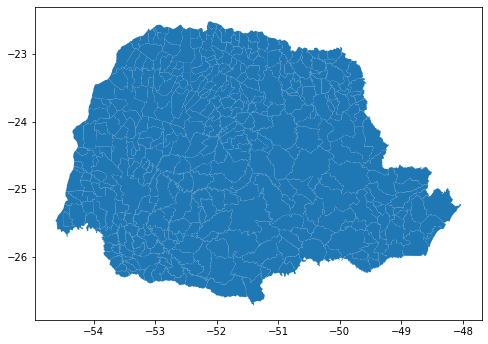

In [6]:
fig, ax = plt.subplots(figsize=(8,8))

pr_mun_df.plot(ax=ax)

In [7]:
viz_df = pd.merge(pr_mun_df, ibge_df, left_on=['CD_MUN'], right_on=['Código'])

viz_df.head()

,CD_MUN,NM_MUN,SIGLA_UF,AREA_KM2,geometry,cases,deaths,vaccinated,Município,Código,...,Prefeito [2021],área Territorial - km2; [2021],População estimada - pessoas [2021],Densidade demográfica - hab/km2; [2010],Escolarização 6 a 14 anos - % [2010],IDHM índice de desenvolvimento humano municipal [2010],Mortalidade infantil - óbitos por mil nascidos vivos [2019],Receitas realizadas - R$ (x1000) [2017],Despesas empenhadas - R$ (x1000) [2017],PIB per capita - R$ [2019]
0,410010,AbatiÃ¡,PR,228.717,"POLYGON ((-50.22465 -23.22603, -50.22561 -23.2...",9266.461043,134.102186,191605.203165,Abatiá,410010,...,NELSON GARCIA JUNIOR,228.717,7360,33.95,96.5,0.687,33.9,21302.47790,17805.68531,25316.37
1,410020,AdrianÃ³polis,PR,1349.311,"POLYGON ((-48.99969 -24.63712, -48.99927 -24.6...",0.000000,0.000000,0.000000,Adrianópolis,410020,...,VANDIR DE OLIVEIRA ROSA,1349.311,5797,4.73,95.8,0.667,-,27896.90718,26008.12705,36344.53
2,410030,Agudos do Sul,PR,192.261,"POLYGON ((-49.30433 -25.94769, -49.30541 -25.9...",4673.994238,149.397076,218674.634511,Agudos do Sul,410030,...,LUCIANE MAIRA TEIXEIRA,192.261,9567,43.01,96.3,0.660,-,23790.02827,21427.99858,23289.03
3,410040,Almirante TamandarÃ©,PR,194.888,"POLYGON ((-49.28261 -25.22827, -49.28076 -25.2...",7052.595197,272.291208,139319.524881,Almirante Tamandaré,410040,...,GERSON DENILSON COLODEL,194.888,121420,529.95,95.6,0.699,6.61,200858.73732,165618.13589,13747.91
4,410045,Altamira do ParanÃ¡,PR,386.945,"POLYGON ((-52.81511 -24.71726, -52.80995 -24.7...",0.000000,0.000000,0.000000,Altamira do Paraná,410045,...,JOSE ETEVALDO DE OLIVEIRA,386.945,1429,11.13,97.5,0.667,-,21885.68263,18892.50535,38678.23


In [8]:
viz_df[['cases', 'deaths', 'vaccinated']] = viz_df[['cases', 'deaths', 'vaccinated']].replace(0, np.nan)


In [40]:
from slugify import slugify

def plot_parana(title, viz_column, cmap, label):
    fig, ax = plt.subplots(1, 1, figsize=(20, 16))

    divider = make_axes_locatable(ax)

    cax = divider.append_axes("right", size="2%", pad="0.5%")

    viz_df.plot(column=viz_column, ax=ax, cax=cax, cmap=cmap,
        legend=True, legend_kwds={"label": label},
        missing_kwds={"color": "lightgrey", "edgecolor": "black", "hatch": "\\\\\\"},
        edgecolor='lightgrey')

    ax.set_title(title)
    
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    fig.tight_layout()
    plt.savefig(f'../temp/{slugify(title)}.png', dpi=150, format='png', transparent=False)

    # plt.close()

    # plt.plot()


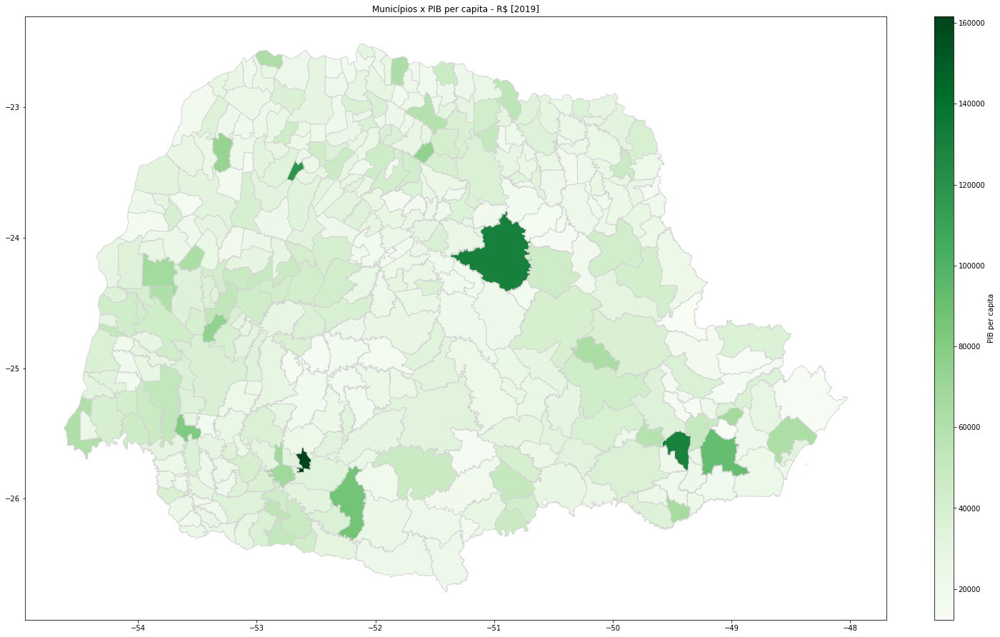

In [42]:
plot_parana('Municípios x PIB per capita - R$ [2019]', 'PIB per capita - R$ [2019]', 'Greens', 'PIB per capita')


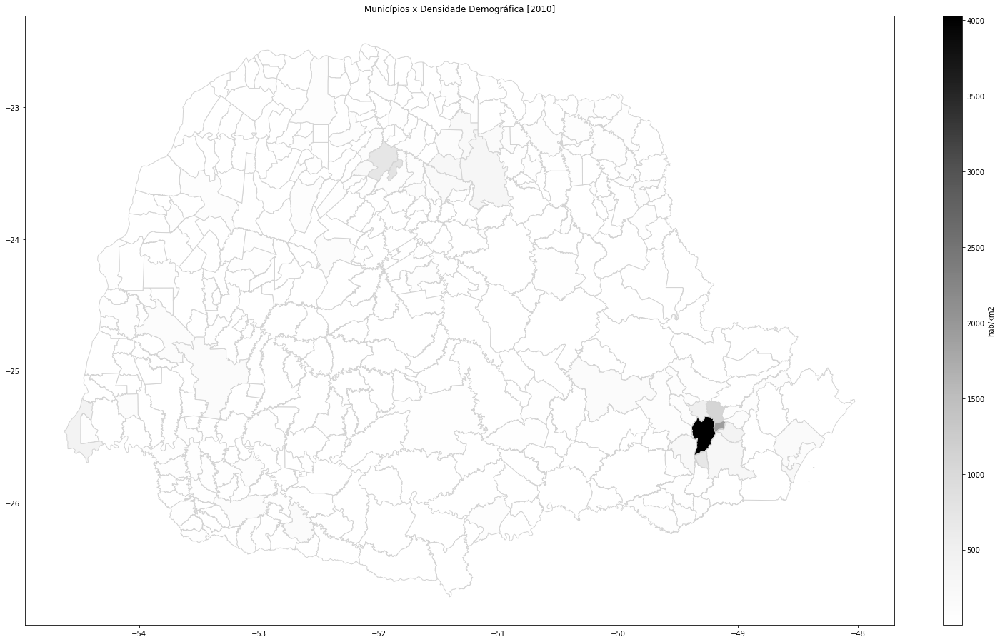

In [43]:
plot_parana('Municípios x Densidade Demográfica [2010]', 'Densidade demográfica - hab/km2; [2010]', 'Greys', 'hab/km2')


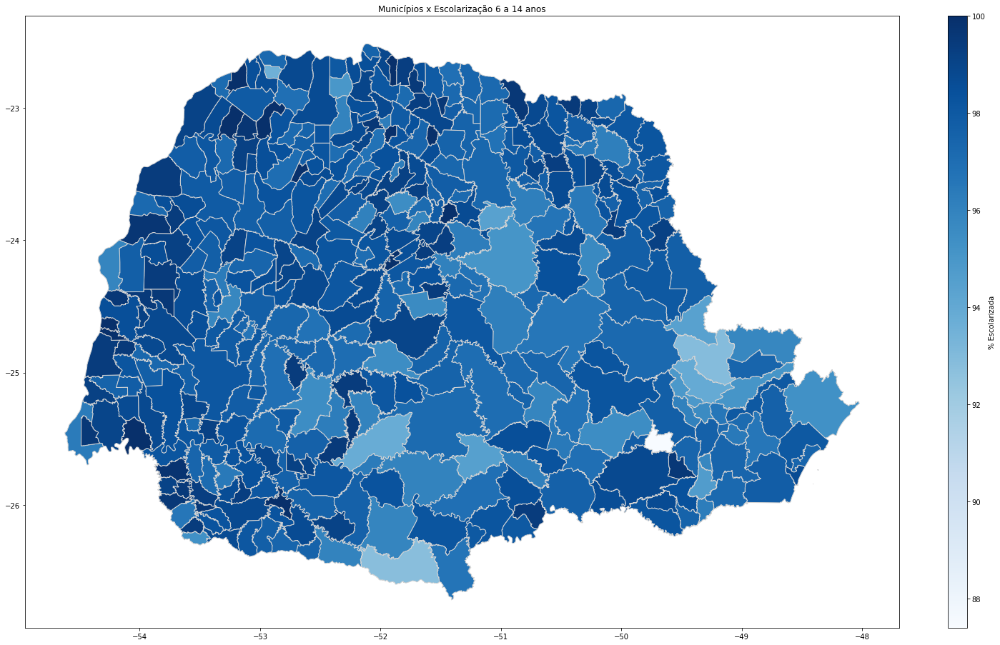

In [44]:
plot_parana('Municípios x Escolarização 6 a 14 anos', 'Escolarização 6 a 14 anos - % [2010]', 'Blues', '% Escolarizada')


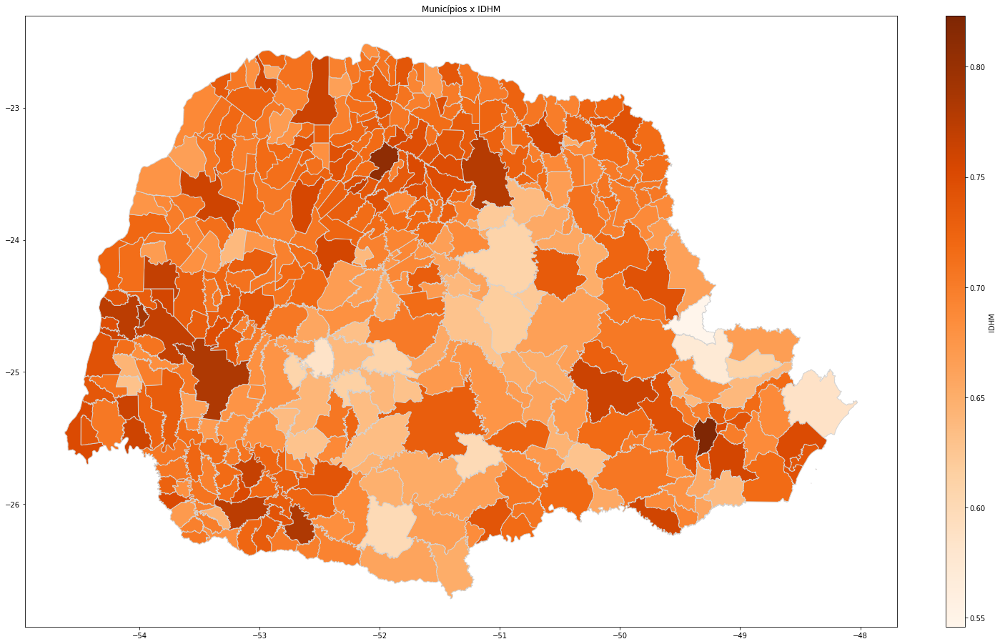

In [45]:
plot_parana('Municípios x IDHM', 'IDHM índice de desenvolvimento humano municipal [2010]', 'Oranges', 'IDHM')


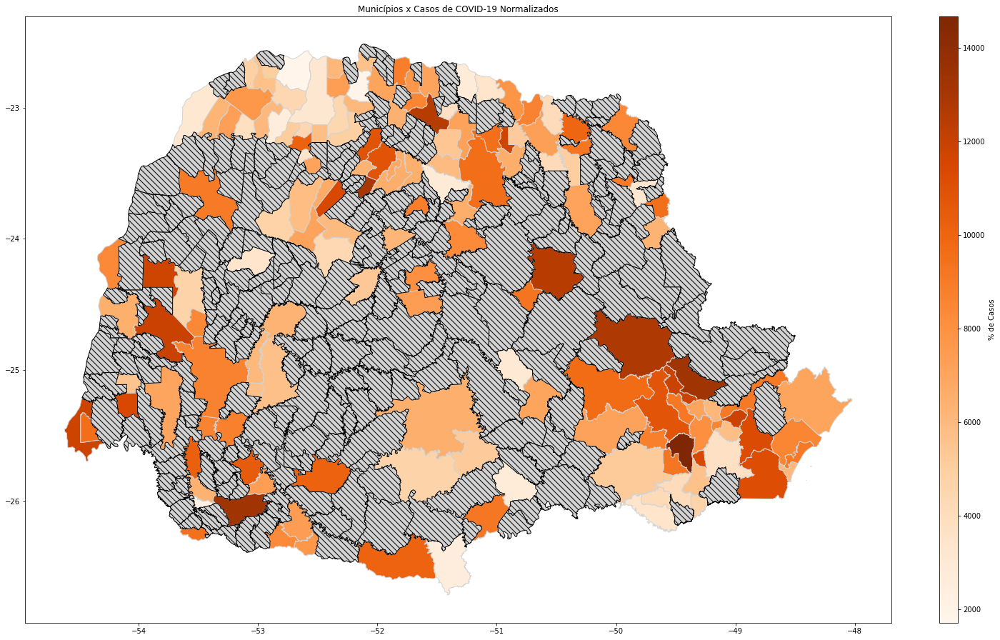

In [46]:
plot_parana('Municípios x Casos de COVID-19 Normalizados', 'cases', 'Oranges', '% de Casos')


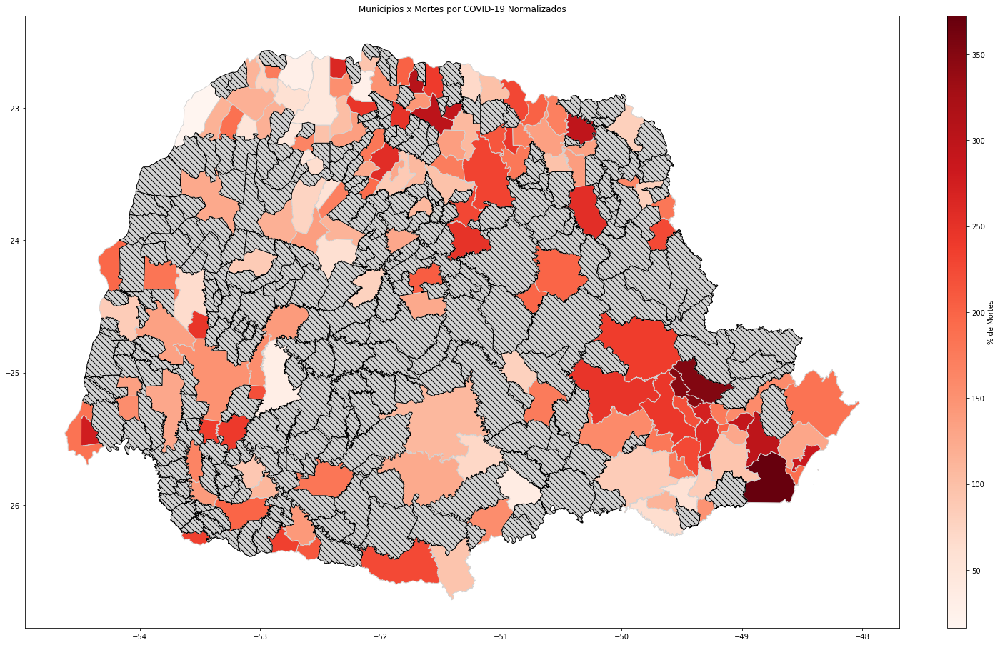

In [47]:
plot_parana('Municípios x Mortes por COVID-19 Normalizados', 'deaths', 'Reds', '% de Mortes')


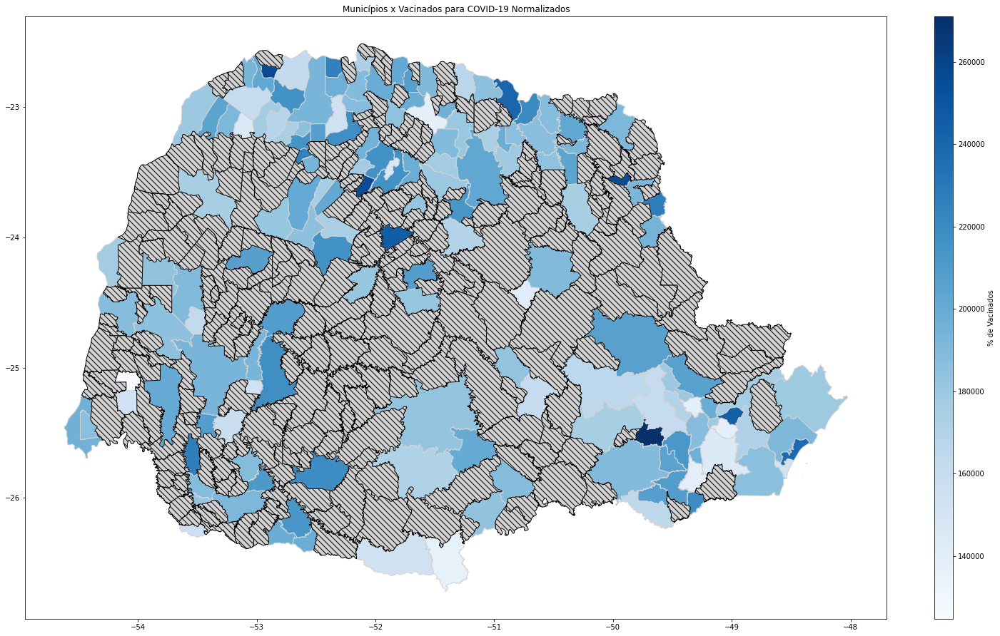

In [48]:
plot_parana('Municípios x Vacinados para COVID-19 Normalizados', 'vaccinated', 'Blues', '% de Vacinados')


In [49]:

m = viz_df.explore(column='cases', tooltip=['Município', 'cases', 'deaths', 'vaccinated', 'População estimada - pessoas [2021]'],
    scheme="naturalbreaks",
    popup=True, cmap="Oranges", legend=True,
    tiles="CartoDB positron",
    style_kwds=dict(color="black", colorbar=False),
    name='Casos',
    missing_kwds={
        "color": "lightgrey",
        "edgecolor": "red",
        "hatch": "|",
        "label": "Missing values",
    })

viz_df.explore(m=m,
    column='deaths',
    scheme="naturalbreaks",
    popup=True, cmap="Reds", legend=True,
    tiles="CartoDB positron",
    style_kwds=dict(color="black", colorbar=False),
    missing_kwds={
        "color": "lightgrey",
        "edgecolor": "red",
        "hatch": "|",
        "label": "Missing values",
    },
    name='Mortes',
    show=False
)

viz_df.explore(m=m,
    column='vaccinated',
    scheme="naturalbreaks",
    popup=True, cmap="Blues", legend=True,
    tiles="CartoDB positron",
    style_kwds=dict(color="black", colorbar=False),
    missing_kwds={
        "color": "lightgrey",
        "edgecolor": "red",
        "hatch": "|",
        "label": "Missing values",
    },
    name='Vacinados',
    show=False
)

# folium.Layer(name='Mortes', show=False)
folium.LayerControl().add_to(m)

m
